There are several examples in this notebook:

1. Augmentation using Augraphy default pipeline.
2. Augmentation using user defined pipeline.
3. Augmentation using batches of images (List).
4. Augmentation using batches of images (4D image array).
5. Augmentation using archetype pipelines (predefined pipeline).

In [16]:
# install Augraphy

!pip install git+https://github.com/sparkfish/augraphy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/sparkfish/augraphy to /tmp/pip-req-build-k_cqcod1
  Running command git clone --filter=blob:none --quiet https://github.com/sparkfish/augraphy /tmp/pip-req-build-k_cqcod1
  Resolved https://github.com/sparkfish/augraphy to commit 2d29ab34303af55a6adc32ef86f26300e27936dc
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


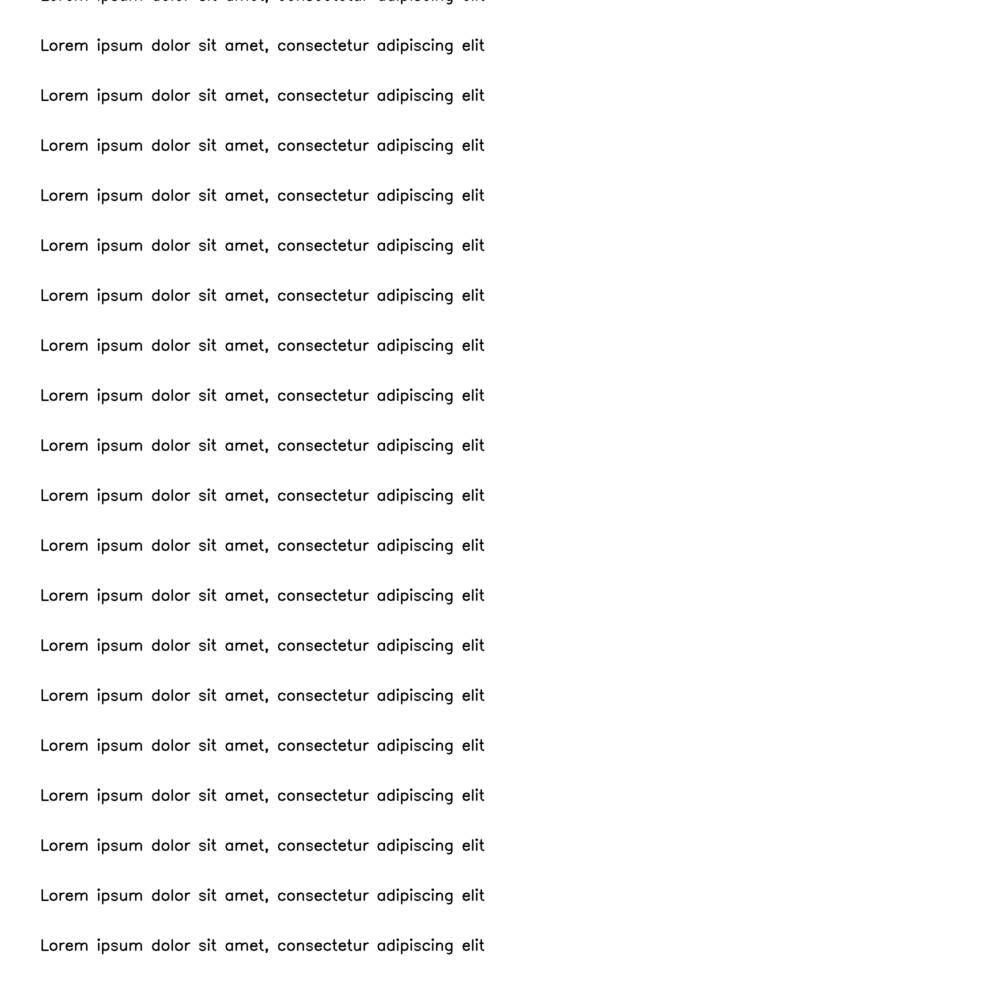

In [20]:
# create an image

import numpy as np
import cv2
from google.colab.patches import cv2_imshow

image = np.full((2000, 2000, 3), 255, dtype="uint8")
for i in range(20):

    font_size = 1
    thickness=2
    
    cv2.putText(
        image,
        "Lorem ipsum dolor sit amet, consectetur adipiscing elit",
        (80, i*100),
        cv2.FONT_HERSHEY_SIMPLEX,
        font_size,
        0,
        thickness,
    )

# display image
cv2_imshow(image)

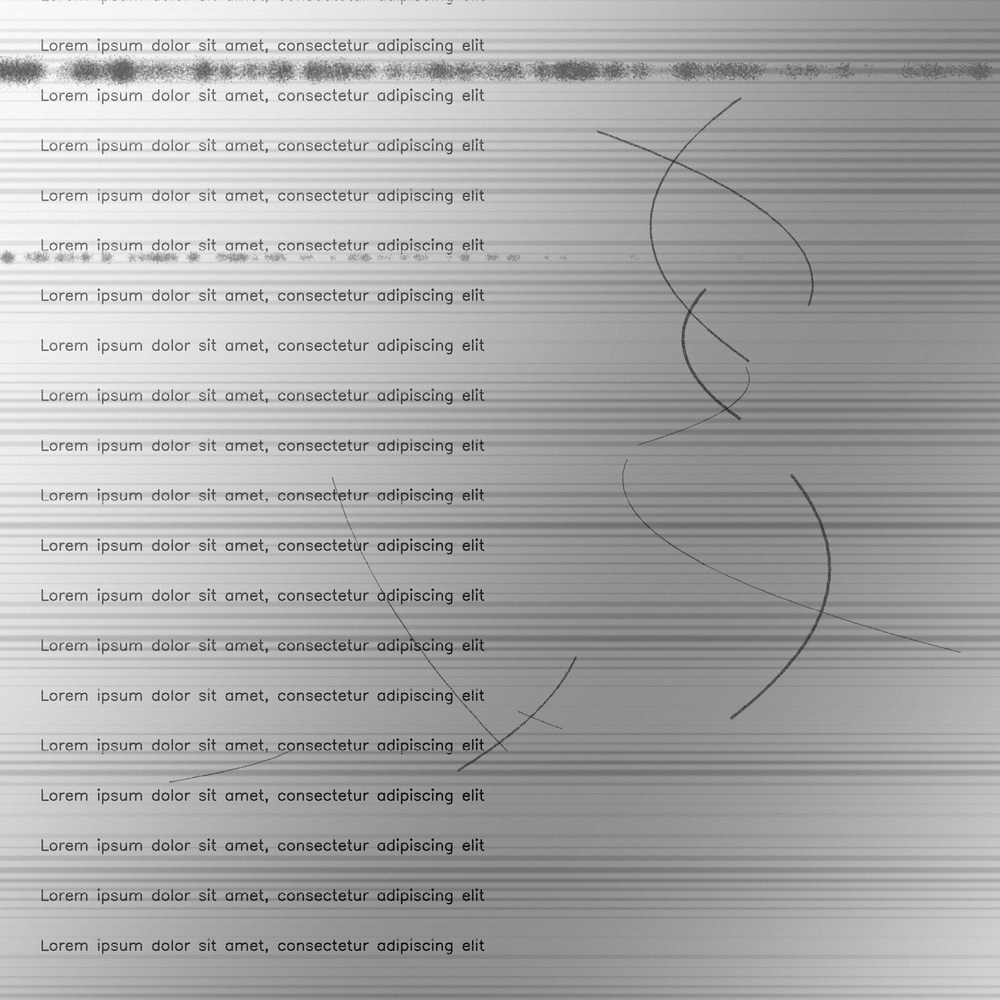

In [22]:
# 1. Augmentation using Augraphy default pipeline.

from augraphy import *

pipeline = default_augraphy_pipeline()

image_augmented = pipeline(image)

# display image
cv2_imshow(image_augmented)


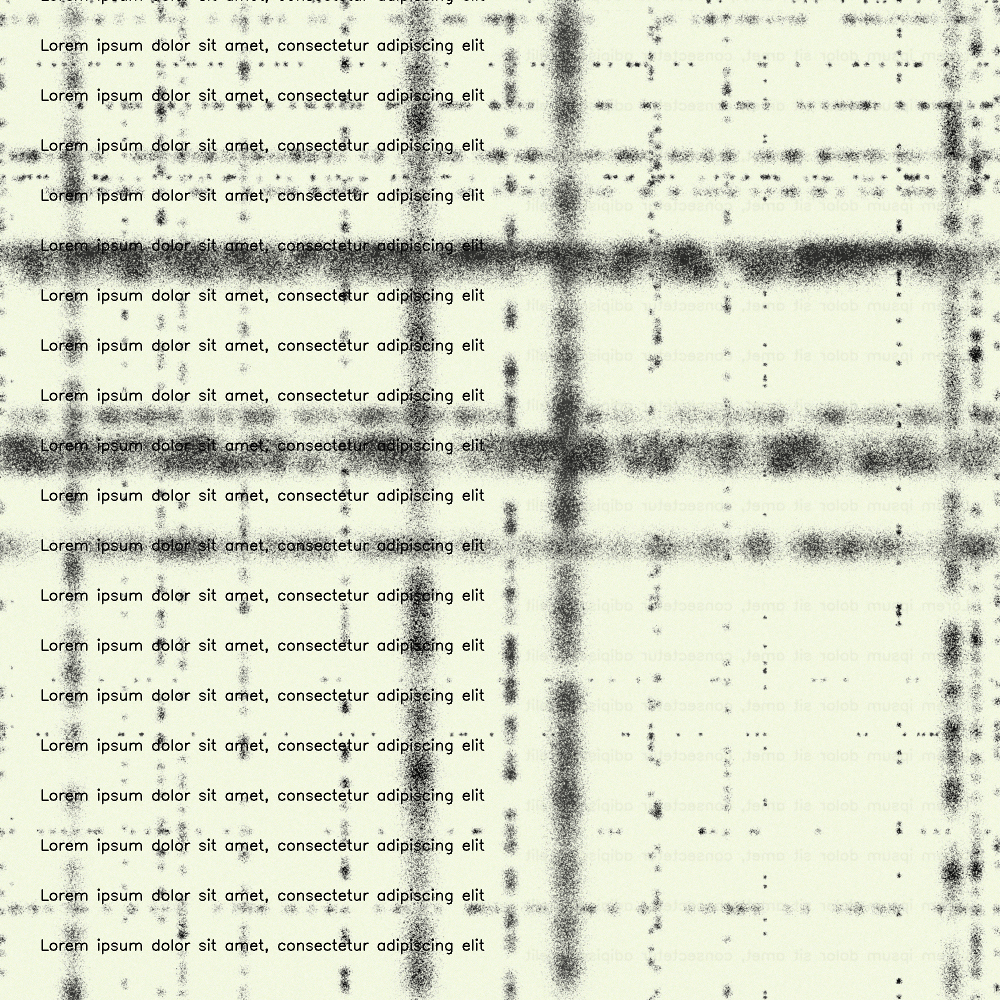

In [23]:
# 2. Augmentation using user defined pipeline.

from augraphy import *

ink_phase = [DirtyDrum()]
paper_phase = [ColorPaper()]
post_phase = [BleedThrough()]

pipeline = AugraphyPipeline(ink_phase, paper_phase, post_phase)

image_augmented = pipeline(image)

# display image
cv2_imshow(image_augmented)

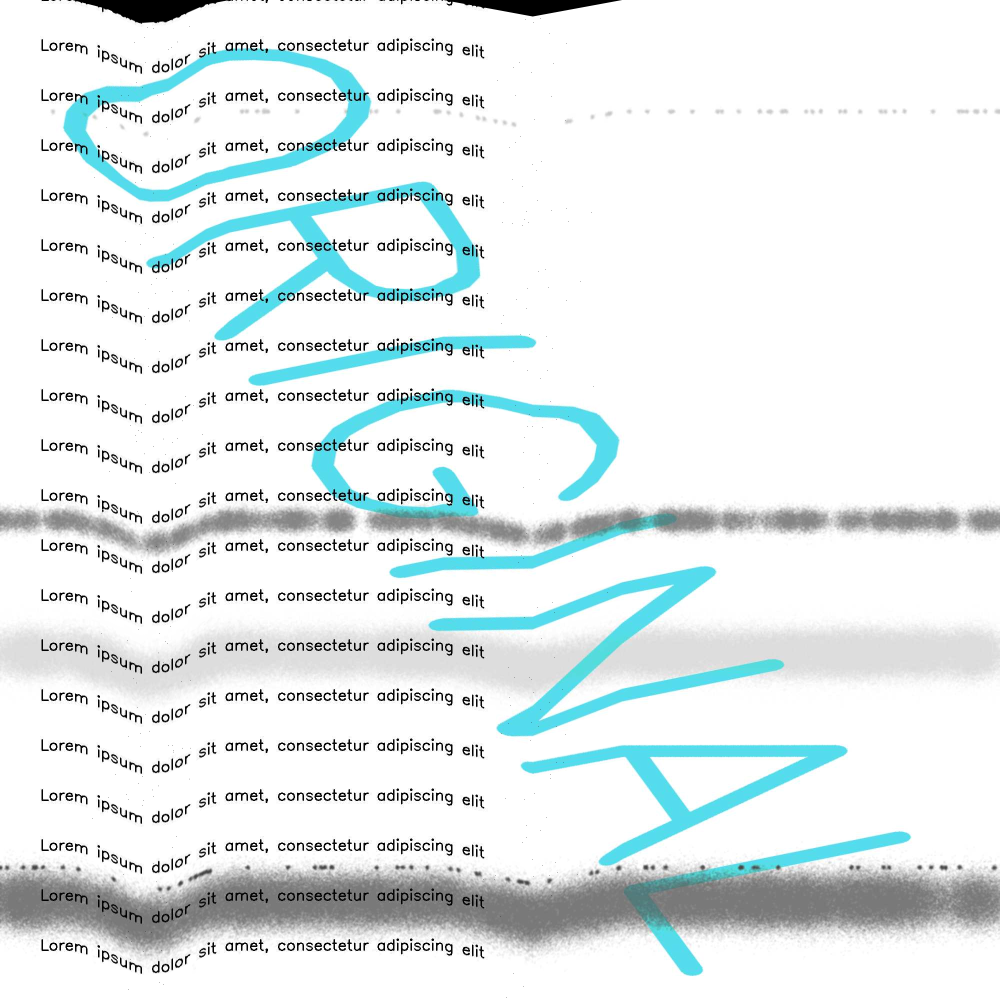

In [24]:
# 3. Augmentation using batches of images (List).

from augraphy import *

pipeline = default_augraphy_pipeline()

# if input is list, output is list too
image_list = [image, image, image]
image_augmented_list = pipeline(image_list)

# display image
cv2_imshow(image_augmented_list[0])

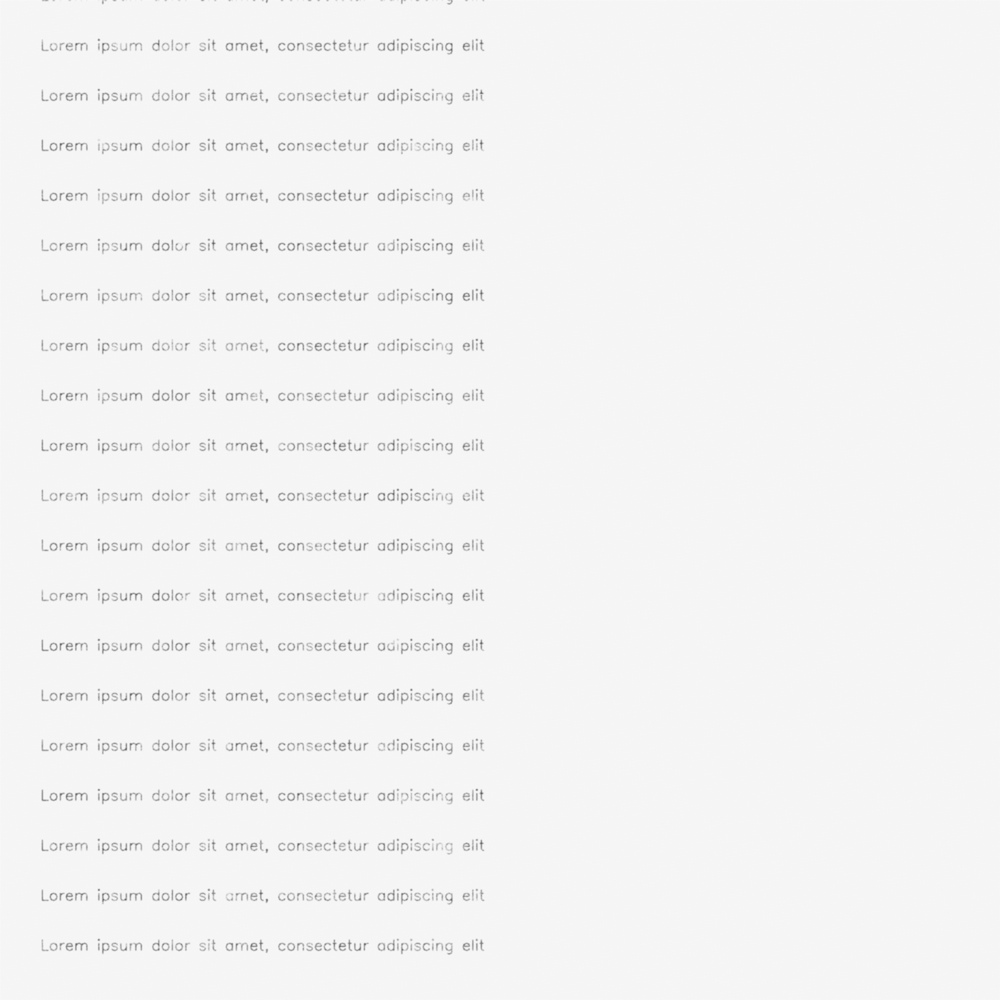

In [30]:
# 4. Augmentation using batches of images (4D numpy array).

from augraphy import *

pipeline = default_augraphy_pipeline()

# (batch size, channel, height, width)
height, width, channels = image.shape
image_4D = np.zeros((2, channels, height, width),dtype=image.dtype)
image_4D[0] = image.reshape(channels, height, width)
image_4D[1] = image.reshape(channels, height, width)
# if input is 4D array, output is 4D array too
image_augmented_4D = pipeline(image_4D)


# display image
# reshape and convert back to 2D image
cv2_imshow(image_augmented_4D[0].reshape(height, width, channels))

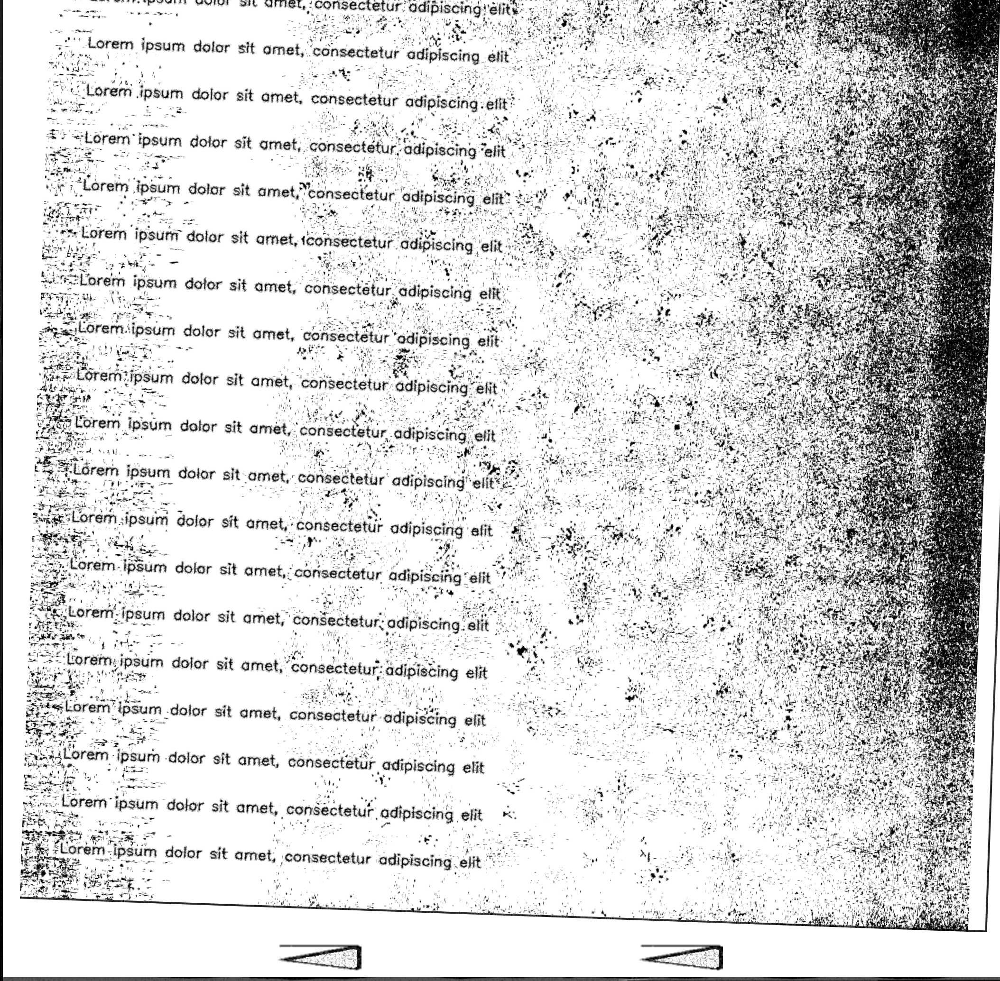

In [35]:
# 5. Augmentation using archetype pipelines (predefined pipeline). There are 10 predefined pipelines now.

from augraphy import *
from augraphy.default.pipeline import *

pipeline = pipeline_archetype5()

image_augmented = pipeline(image)

# display image
cv2_imshow(image_augmented)